In [1]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.print_figure_kwargs={'facecolor' : "w"}

In [2]:
import pandas as pd
import numpy as np
from sklearn.model_selection import RepeatedStratifiedKFold
from torch.utils.data import DataLoader
import timm
from timm import optim, scheduler
import torch
from torch import nn
from torch.optim.lr_scheduler import ExponentialLR
from torchvision import transforms as tfm
from sklearn import metrics as skmet

from dataset import ImageData
import model as my_model
import train

In [3]:
bs = 64  # batch size for training
num_workers = 5  # number of parallel data loading workers
res = 224 # pixel size along height and width
device = torch.device('cuda:0')
num_classes = 3
keep_views = ['AP_LIKE']

In [4]:
tfms = tfm.Compose([
    tfm.Resize(res),
    tfm.CenterCrop(res),
    tfm.ToTensor(),
    tfm.Normalize(mean=torch.Tensor([0.4850, 0.4560, 0.4060]), std=torch.Tensor([0.2290, 0.2240, 0.2250])),
    tfm.Grayscale()
])

In [7]:
df_img = pd.read_csv('../data/model_images.csv')
df_trg = pd.read_csv('../data/model_targets.csv')

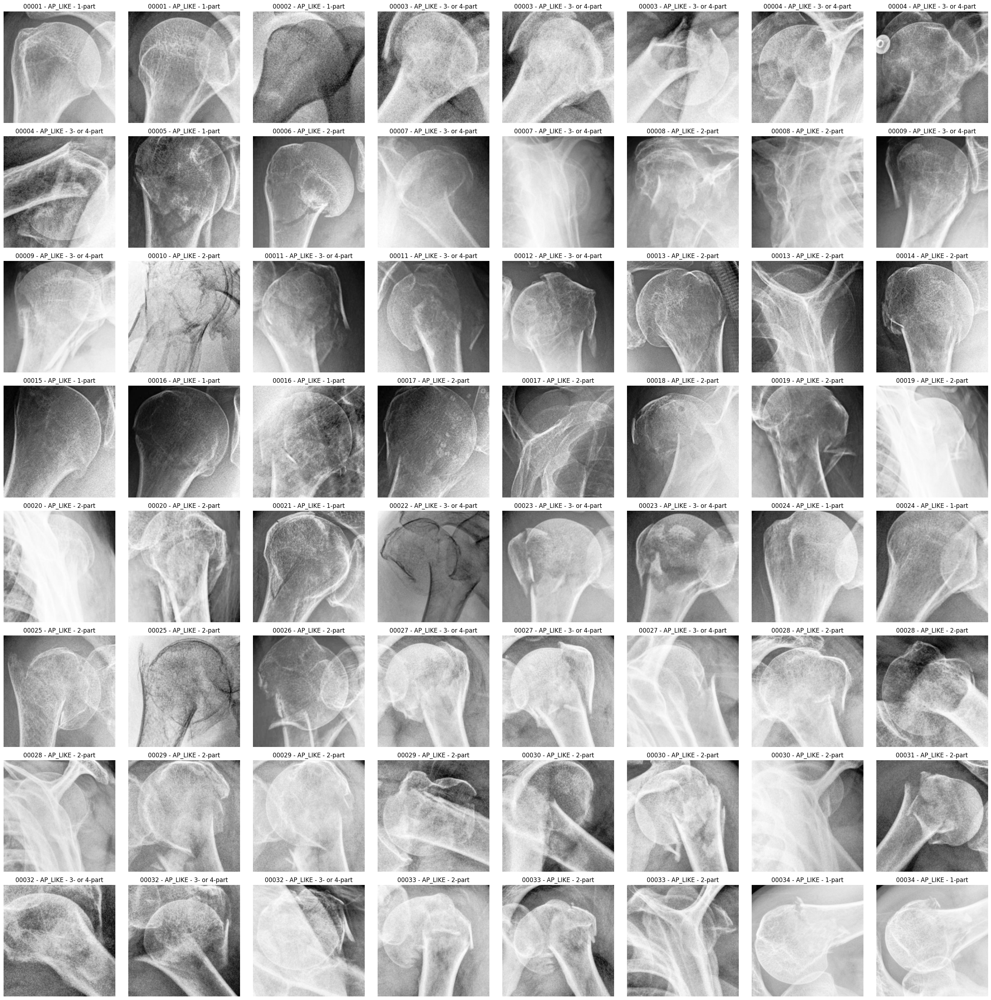

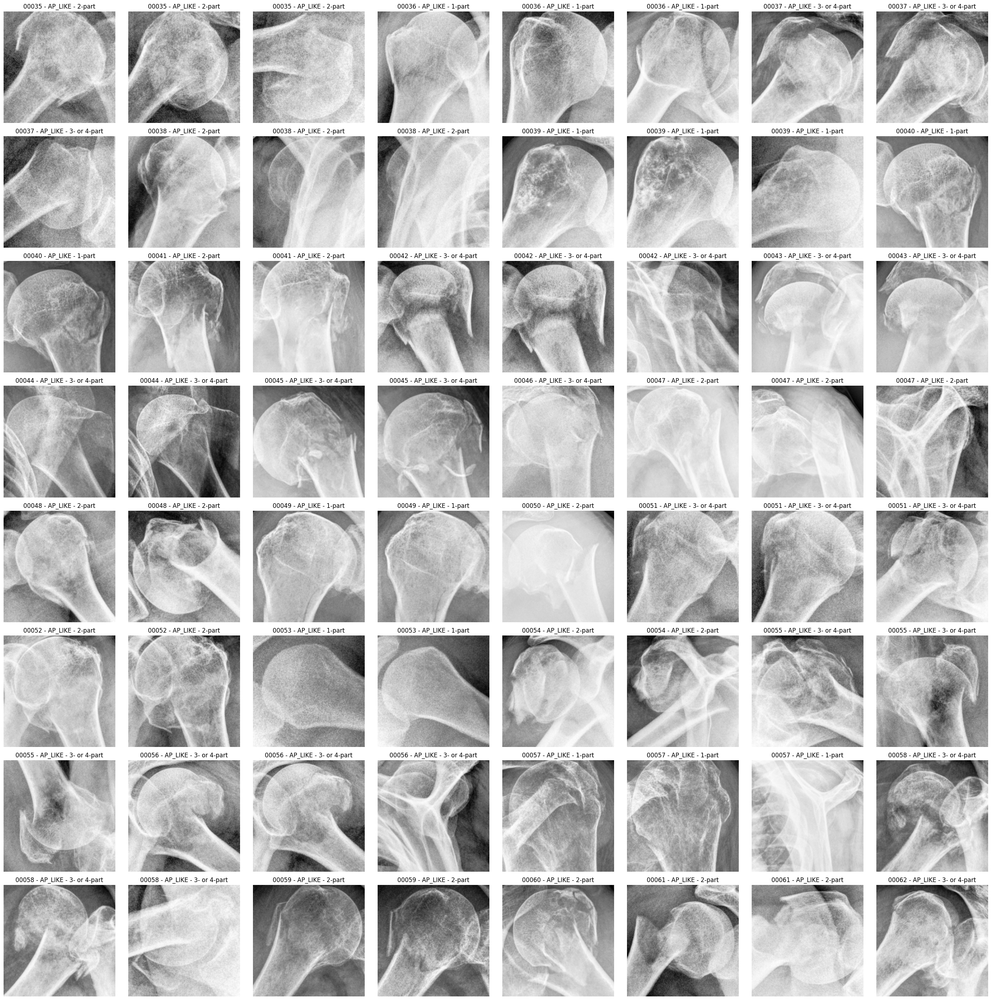

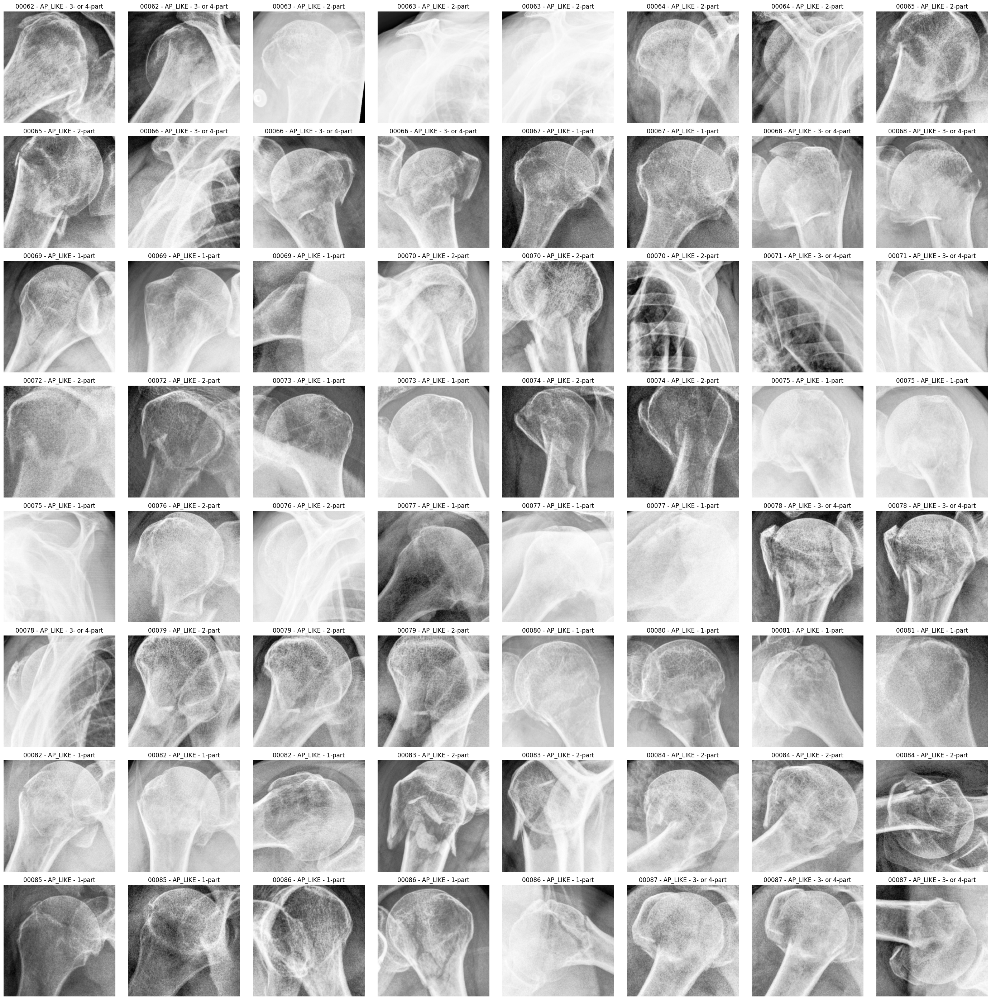

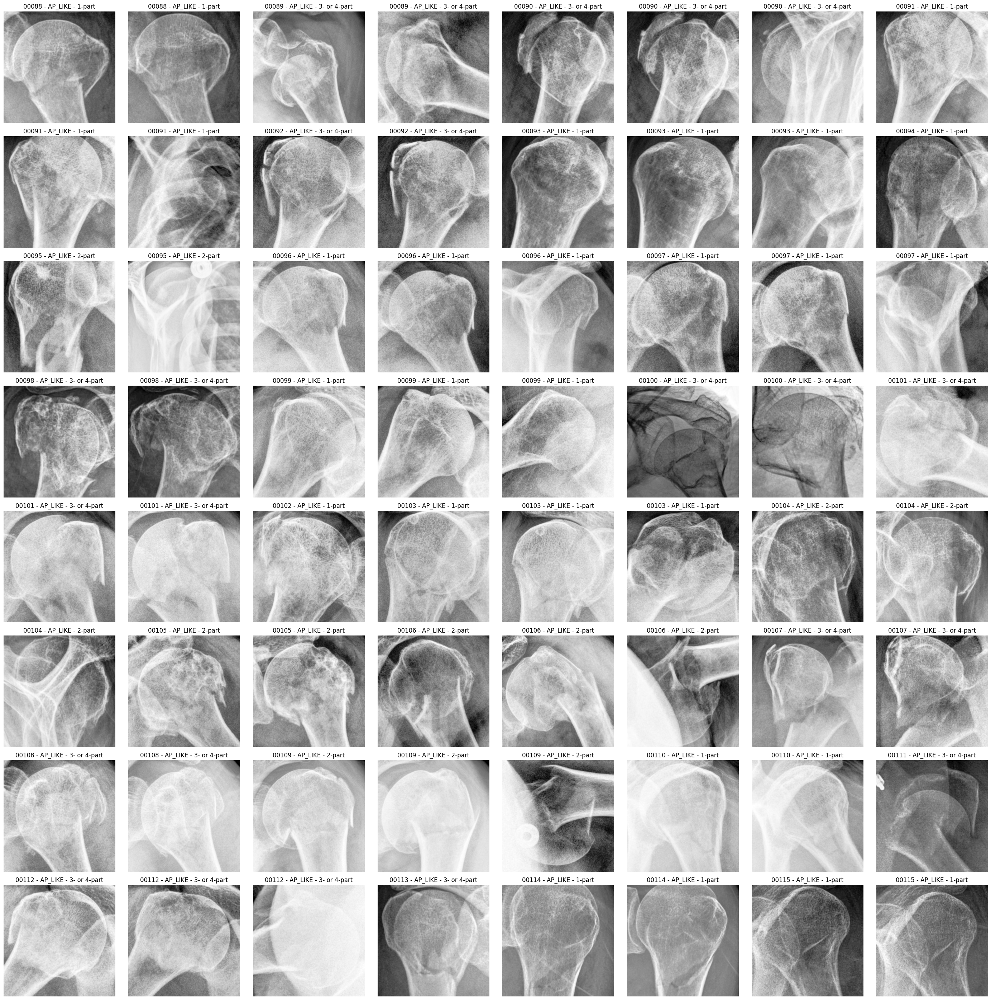


KeyboardInterrupt



In [8]:
# create datasets
df = df_trg.merge(df_img)
d = ImageData(df, transforms = tfms, view_filter=keep_views)
dl = DataLoader(d, batch_size=bs, num_workers=num_workers)

for ix, batch in enumerate(dl):
    ImageData.display_batch(batch, height=28)